In [1]:
# importing libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error
import statsmodels.api as sm
import pandas as pd
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso, Ridge
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [3]:
import tarfile

# Extract the tar.gz file
with tarfile.open('Users/Ebenelomo/Movie_sentiment/aclImdb_v1.tar.gz', 'r:gz') as tar:
    tar.extractall('extracted_data')  # Extract contents to the folder 'extracted_data'

StatementMeta(4eff8d26-11de-4fa8-8984-9947ca8c930a, 1, 8, Finished, Available, Finished)

In [2]:
import os
import pandas as pd

# Define the base directory for the extracted data
base_dir = 'extracted_data/aclImdb'

# Initialize empty lists to store the data
reviews = []
sentiments = []

# Helper function to read reviews from a directory
def read_reviews_from_dir(directory, sentiment_label):
    for filename in os.listdir(directory):
        if filename.endswith('.txt'):
            with open(os.path.join(directory, filename), 'r', encoding='utf-8') as file:
                reviews.append(file.read())  # Read the content of the review
                sentiments.append(sentiment_label)  # Append the corresponding sentiment

# Read positive reviews
read_reviews_from_dir(os.path.join(base_dir, 'train/pos'), 'positive')
read_reviews_from_dir(os.path.join(base_dir, 'train/neg'), 'negative')
read_reviews_from_dir(os.path.join(base_dir, 'test/pos'), 'positive')
read_reviews_from_dir(os.path.join(base_dir, 'test/neg'), 'negative')

# Create a DataFrame from the lists
df = pd.DataFrame({
    'review': reviews,
    'sentiment': sentiments
})

# Display the first few rows of the DataFrame
print(df.head())


                                              review sentiment
0  Bromwell High is a cartoon comedy. It ran at t...  positive
1  Homelessness (or Houselessness as George Carli...  positive
2  Brilliant over-acting by Lesley Ann Warren. Be...  positive
3  This is easily the most underrated film inn th...  positive
4  This is not the typical Mel Brooks film. It wa...  positive


In [3]:
import pandas as pd
import nltk
import re
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Function to clean text
def clean_text(text):
    # 1. Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))
    
    # 2. Convert to lowercase
    text = text.lower()
    
    # 3. Tokenize the text
    tokens = word_tokenize(text)
    
    # 4. Remove stopwords
    stop_words = set(stopwords.words('english'))
    cleaned_tokens = [word for word in tokens if word not in stop_words]
    
    return cleaned_tokens

# Apply the cleaning function to the 'review' column
df['cleaned_review'] = df['review'].apply(clean_text)

# Display the cleaned DataFrame
print(df[['review', 'cleaned_review']])

                                                  review  \
0      Bromwell High is a cartoon comedy. It ran at t...   
1      Homelessness (or Houselessness as George Carli...   
2      Brilliant over-acting by Lesley Ann Warren. Be...   
3      This is easily the most underrated film inn th...   
4      This is not the typical Mel Brooks film. It wa...   
...                                                  ...   
49995  I occasionally let my kids watch this garbage ...   
49996  When all we have anymore is pretty much realit...   
49997  The basic genre is a thriller intercut with an...   
49998  Four things intrigued me as to this film - fir...   
49999  David Bryce's comments nearby are exceptionall...   

                                          cleaned_review  
0      [bromwell, high, cartoon, comedy, ran, time, p...  
1      [homelessness, houselessness, george, carlin, ...  
2      [brilliant, overacting, lesley, ann, warren, b...  
3      [easily, underrated, film, inn, broo

In [4]:
negative_reviews['review'].to_csv('negative_reviews.txt', index=False, header=False)
for review in negative_reviews['review'].values:
    print(review)

Story of a man who has unnatural feelings for a pig. Starts out with a opening scene that is a terrific example of absurd comedy. A formal orchestra audience is turned into an insane, violent mob by the crazy chantings of it's singers. Unfortunately it stays absurd the WHOLE time with no general narrative eventually making it just too off putting. Even those from the era should be turned off. The cryptic dialogue would make Shakespeare seem easy to a third grader. On a technical level it's better than you might think with some good cinematography by future great Vilmos Zsigmond. Future stars Sally Kirkland and Frederic Forrest can be seen briefly.
Airport '77 starts as a brand new luxury 747 plane is loaded up with valuable paintings & such belonging to rich businessman Philip Stevens (James Stewart) who is flying them & a bunch of VIP's to his estate in preparation of it being opened to the public as a museum, also on board is Stevens daughter Julie (Kathleen Quinlan) & her son. The l

In [6]:
pip install nltk

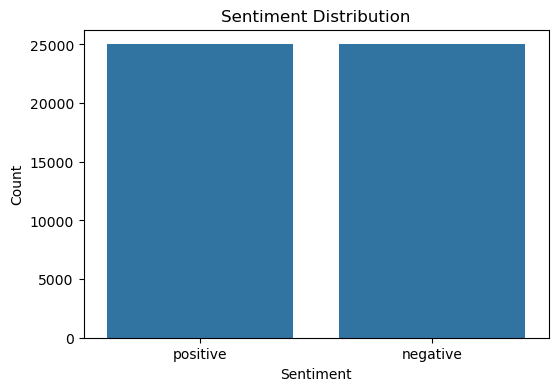

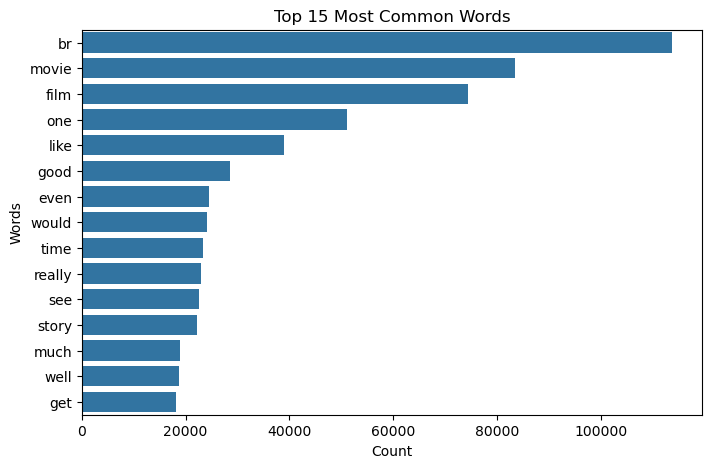

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import pandas as pd

# 1. Visualize the distribution of sentiments
plt.figure(figsize=(6, 4))
sns.countplot(x='sentiment', data=df)
plt.title('Sentiment Distribution')
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.show()

# 2. Visualize the most common words in the cleaned reviews
# Flatten the list of cleaned words
all_words = [word for review in df['cleaned_review'] for word in review]

# Get the most common words using collections.Counter
word_counts = Counter(all_words)
common_words = word_counts.most_common(15)  # Top 15 most common words

# Convert common words to a DataFrame for visualization
common_words_df = pd.DataFrame(common_words, columns=['word', 'count'])

# Plot the most common words
plt.figure(figsize=(8, 5))
sns.barplot(x='count', y='word', data=common_words_df)
plt.title('Top 15 Most Common Words')
plt.xlabel('Count')
plt.ylabel('Words')
plt.show()

In [5]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer

# Join the tokens back into sentences for TF-IDF
df['cleaned_review_text'] = df['cleaned_review'].apply(lambda x: ' '.join(x))

# Initialize the TF-IDF Vectorizer with limited vocabulary size and reduced dtype
tfidf_vectorizer = TfidfVectorizer()

# Fit and transform the cleaned review text (work directly with sparse matrix)
tfidf_matrix = tfidf_vectorizer.fit_transform(df['cleaned_review_text'])

# Avoid converting to dense (no .toarray()), instead work directly with the sparse matrix
# If you still need to inspect, convert a portion of it to dense as needed
tfidf_df = pd.DataFrame.sparse.from_spmatrix(tfidf_matrix, columns=tfidf_vectorizer.get_feature_names_out())

# Display the first few rows of the resulting sparse DataFrame
print(tfidf_df)

       00  000  0000000000001  00000001  000001  00000110  0001  00015  001  \
0       0    0              0         0       0         0     0      0    0   
1       0    0              0         0       0         0     0      0    0   
2       0    0              0         0       0         0     0      0    0   
3       0    0              0         0       0         0     0      0    0   
4       0    0              0         0       0         0     0      0    0   
...    ..  ...            ...       ...     ...       ...   ...    ...  ...   
49995   0    0              0         0       0         0     0      0    0   
49996   0    0              0         0       0         0     0      0    0   
49997   0    0              0         0       0         0     0      0    0   
49998   0    0              0         0       0         0     0      0    0   
49999   0    0              0         0       0         0     0      0    0   

       0010  ...  überwoman  ünel  ünfaithful  üveg

In [8]:
tfidf_df.info()

StatementMeta(4eff8d26-11de-4fa8-8984-9947ca8c930a, 4, 13, Finished, Available, Finished)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Columns: 180347 entries, 00 to כרמון
dtypes: Sparse[float64, 0](180347)
memory usage: 57.6 MB


In [4]:
import nltk
nltk.download('stopwords')


StatementMeta(4eff8d26-11de-4fa8-8984-9947ca8c930a, 4, 9, Finished, Available, Finished)

[nltk_data] Downloading package stopwords to /home/trusted-service-
[nltk_data]     user/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [10]:
pip list

StatementMeta(4eff8d26-11de-4fa8-8984-9947ca8c930a, 3, 15, Finished, Available, Finished)

Package                       Version
----------------------------- --------------------
absl-py                       1.3.0
adal                          1.2.7
adlfs                         0.7.7
aiohttp                       3.8.3
aiosignal                     1.3.1
anyio                         3.6.2
applicationinsights           0.11.10
argcomplete                   2.0.0
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
asttokens                     2.1.0
astunparse                    1.6.3
async-timeout                 4.0.2
attrs                         22.1.0
azure-common                  1.1.28
azure-core                    1.26.1
azure-datalake-store          0.0.51
azure-graphrbac               0.61.1
azure-identity                1.7.0
azure-mgmt-authorization      2.0.0
azure-mgmt-containerregistry  10.0.0
azure-mgmt-core               1.3.2
azure-mgmt-keyvault           10.1.0
azure-mgmt-resource           21.2.1
azure-mgmt-storage            20.1.

In [11]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout
from tensorflow.keras.layers import Bidirectional
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split

# Convert sentiments to numerical labels (positive -> 1, negative -> 0)
df['label'] = df['sentiment'].apply(lambda x: 1 if x == 'positive' else 0)

# Tokenize the text
max_words = 10000  # Limit the vocabulary size
max_len = 100  # Limit the sequence length

tokenizer = Tokenizer(num_words=max_words)
tokenizer.fit_on_texts(df['cleaned_review_text'])
sequences = tokenizer.texts_to_sequences(df['cleaned_review_text'])
word_index = tokenizer.word_index

# Pad the sequences to ensure uniform input size
data = pad_sequences(sequences, maxlen=max_len)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, df['label'], test_size=0.2)

# Build the LSTM model
model = Sequential()
model.add(Embedding(input_dim=max_words, output_dim=128, input_length=max_len))
model.add(Bidirectional(LSTM(128, return_sequences=False)))
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Set up early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Train the model with early stopping
model.fit(
    X_train, 
    y_train, 
    epochs=10,  # Increased epochs for potential further improvement
    batch_size=32, 
    validation_data=(X_test, y_test), 
    callbacks=[early_stopping]
)

# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {accuracy}")


Epoch 1/10


c:\Users\ebene\anaconda3\envs\Project\Lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 296s 230ms/step - accuracy: 0.7906 - loss: 0.4288 - val_accuracy: 0.8790 - val_loss: 0.2990
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 329s 235ms/step - accuracy: 0.9146 - loss: 0.2192 - val_accuracy: 0.8834 - val_loss: 0.2998
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 317s 254ms/step - accuracy: 0.9443 - loss: 0.1527 - val_accuracy: 0.8797 - val_loss: 0.3253
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 316s 249ms/step - accuracy: 0.9648 - loss: 0.1015 - val_accuracy: 0.8668 - val_loss: 0.3686
313/313 ━━━━━━━━━━━━━━━━━━━━ 26s 84ms/step - accuracy: 0.8820 - loss: 0.2860
Test Accuracy: 0.8790000081062317


In [12]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import numpy as np

# Assuming 'model' is your trained LSTM model and 'X_test' is your test data
# 'y_test' is the true labels for the test data

# Predicting the probabilities
y_pred_prob = model.predict(X_test)

# Convert probabilities to binary predictions (threshold = 0.5 for binary classification)
y_pred = (y_pred_prob > 0.5).astype(int)

# Accuracy
accuracy = accuracy_score(y_test, y_pred)

# Precision
precision = precision_score(y_test, y_pred)

# Recall
recall = recall_score(y_test, y_pred)

# F1-score
f1 = f1_score(y_test, y_pred)

# Print the results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")

313/313 ━━━━━━━━━━━━━━━━━━━━ 27s 81ms/step
Accuracy: 0.8790
Precision: 0.8585
Recall: 0.9116
F1-score: 0.8843


In [13]:
from tensorflow.keras.models import load_model

# Assuming your LSTM model is named 'model'
# Save the model
model.save('sentiment_model.h5')

print("Model saved as sentiment_model.h5")


Model saved as sentiment_model.h5


In [14]:
import pickle
# Assuming 'tokenizer' is your Tokenizer object
with open('tokenizer.pickle', 'wb') as handle:
    pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [10]:
try:
    with open('tokenizer.pickle', 'rb') as handle:
        tokenizer = pickle.load(handle)
except FileNotFoundError:
    print("Tokenizer file not found. Please train and save the tokenizer.")
    # Handle the error or exit the application